This notebook implements PS-Eval, a metric to evaluate whether Sparse Autoencoders (SAEs) can accurately capture the meanings of polysemous words in different contexts.

# [1] Import

In [ ]:
# Standard imports
import os
import torch
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

# Imports for displaying vis in Colab / notebook
import webbrowser
import http.server
import socketserver
import threading
PORT = 6666
torch.set_grad_enabled(False);

from google.colab import output
torch.set_grad_enabled(False);
def display_vis_inline(filename: str, height: int = 850):
    '''
    Displays the HTML files in Colab. Uses global `PORT` variable defined in prev cell, so that each
    vis has a unique port without having to define a port within the function.
    '''
    global PORT

    def serve(directory):
        os.chdir(directory)

        # Create a handler for serving files
        handler = http.server.SimpleHTTPRequestHandler

        # Create a socket server with the handler
        with socketserver.TCPServer(("", PORT), handler) as httpd:
            print(f"Serving files from {directory} on port {PORT}")
            httpd.serve_forever()

    thread = threading.Thread(target=serve, args=("/content",))
    thread.start()

    output.serve_kernel_port_as_iframe(PORT, path=f"/{filename}", height=height, cache_in_notebook=True)

    PORT += 1

In [ ]:
!pip install --upgrade sae-lens datasets transformer_lens sae_dashboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.1/143.1 kB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.0/920.0 kB 21.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 527.3/527.3 kB 43.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.5/177.5 kB 18.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.1/141.1 kB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 739.7/739.7 kB 42.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 4.9 MB/s eta 0:00:00
   ━━━━

In [ ]:
# %pip install sae-lens==0.1.0
import sys
from transformer_lens import HookedTransformer
from transformer_lens import utils
from functools import partial
from sae_lens import SAE

In [ ]:
# For the most part I'll try to import functions and classes near where they are used
# to make it clear where they come from.

if torch.backends.mps.is_available():
    device = "mps"
else:
    device = "cuda" if torch.cuda.is_available() else "cpu"

print(f"Device: {device}")

Device: cuda


# [2] Utils

In [ ]:
from typing import Any, Callable, Dict, List, Optional, Tuple, Union, cast
import pandas as pd


def remove_batch_dim(tensor):
    """
    Removes the first dimension of a tensor if it is size 1, otherwise returns the tensor unchanged
    """
    if tensor.shape[0] == 1:
        return tensor.squeeze(0)
    else:
        return tensor

def test_prompt_output(
    prompt: str,
    answer: str,
    model,  # Can't give type hint due to circular imports
    prepend_space_to_answer: bool = True,
    print_details: bool = True,
    prepend_bos: Optional[bool] = None,
    top_k: int = 10,

) -> None:
    """Test if the Model Can Give the Correct Answer to a Prompt.

    Intended for exploratory analysis. Prints out the performance on the answer (rank, logit, prob),
    as well as the top k tokens. Works for multi-token prompts and multi-token answers.

    Warning:

    This will print the results (it does not return them).

    Examples:

    >>> from transformer_lens import HookedTransformer, utils
    >>> model = HookedTransformer.from_pretrained("tiny-stories-1M")
    Loaded pretrained model tiny-stories-1M into HookedTransformer

    >>> prompt = "Why did the elephant cross the"
    >>> answer = "road"
    >>> utils.test_prompt(prompt, answer, model)
    Tokenized prompt: ['<|endoftext|>', 'Why', ' did', ' the', ' elephant', ' cross', ' the']
    Tokenized answer: [' road']
    Performance on answer token:
    Rank: 2        Logit: 14.24 Prob:  3.51% Token: | road|
    Top 0th token. Logit: 14.51 Prob:  4.59% Token: | ground|
    Top 1th token. Logit: 14.41 Prob:  4.18% Token: | tree|
    Top 2th token. Logit: 14.24 Prob:  3.51% Token: | road|
    Top 3th token. Logit: 14.22 Prob:  3.45% Token: | car|
    Top 4th token. Logit: 13.92 Prob:  2.55% Token: | river|
    Top 5th token. Logit: 13.79 Prob:  2.25% Token: | street|
    Top 6th token. Logit: 13.77 Prob:  2.21% Token: | k|
    Top 7th token. Logit: 13.75 Prob:  2.16% Token: | hill|
    Top 8th token. Logit: 13.64 Prob:  1.92% Token: | swing|
    Top 9th token. Logit: 13.46 Prob:  1.61% Token: | park|
    Ranks of the answer tokens: [(' road', 2)]

    Args:
        prompt:
            The prompt string, e.g. "Why did the elephant cross the".
        answer:
            The answer, e.g. "road". Note that if you set prepend_space_to_answer to False, you need
            to think about if you have a space before the answer here (as e.g. in this example the
            answer may really be " road" if the prompt ends without a trailing space).
        model:
            The model.
        prepend_space_to_answer:
            Whether or not to prepend a space to the answer. Note this will only ever prepend a
            space if the answer doesn't already start with one.
        print_details:
            Print the prompt (as a string but broken up by token), answer and top k tokens (all
            with logit, rank and probability).
        prepend_bos:
            Overrides self.cfg.default_prepend_bos if set. Whether to prepend
            the BOS token to the input (applicable when input is a string). Models generally learn
            to use the BOS token as a resting place for attention heads (i.e. a way for them to be
            "turned off"). This therefore often improves performance slightly.
        top_k:
            Top k tokens to print details of (when print_details is set to True).

    Returns:
        None (just prints the results directly).
    """
    if prepend_space_to_answer and not answer.startswith(" "):
        answer = " " + answer
    # GPT-2 often treats the first token weirdly, so lets give it a resting position
    prompt_tokens = model.to_tokens(prompt, prepend_bos=prepend_bos)
    answer_tokens = model.to_tokens(answer, prepend_bos=False)
    tokens = torch.cat((prompt_tokens, answer_tokens), dim=1)
    prompt_str_tokens = model.to_str_tokens(prompt, prepend_bos=prepend_bos)
    answer_str_tokens = model.to_str_tokens(answer, prepend_bos=False)
    prompt_length = len(prompt_str_tokens)
    answer_length = len(answer_str_tokens)
    # if print_details:
    #     print("Tokenized prompt:", prompt_str_tokens)
    #     print("Tokenized answer:", answer_str_tokens)
    logits = remove_batch_dim(model(tokens))
    probs = logits.softmax(dim=-1)
    answer_ranks = []
    for index in range(prompt_length, prompt_length + answer_length):
        answer_token = tokens[0, index]
        answer_str_token = answer_str_tokens[index - prompt_length]
        # Offset by 1 because models predict the NEXT token
        token_probs = probs[index - 1]
        sorted_token_probs, sorted_token_values = token_probs.sort(descending=True)
        # Janky way to get the index of the token in the sorted list - I couldn't find a better way?
        correct_rank = torch.arange(len(sorted_token_values))[
            (sorted_token_values == answer_token).cpu()
        ].item()
        answer_ranks.append((answer_str_token, correct_rank))
        df = pd.DataFrame()
        if print_details:
            # String formatting syntax - the first number gives the number of characters to pad to, the second number gives the number of decimal places.
            # rprint gives rich text printing
            for i in range(top_k):
                # if print_details:
                #     print(
                #         f"Top {i}th token. Logit: {logits[index-1, sorted_token_values[i]].item():5.2f} Prob: {sorted_token_probs[i].item():6.2%} Token: |{model.to_string(sorted_token_values[i])}|"
                #     )
                # append df
                df[model.to_string(sorted_token_values[i]) + "_logit"] = [logits[index-1, sorted_token_values[i]].item()]
                df[model.to_string(sorted_token_values[i]) + "_prob"] = [sorted_token_probs[i].item()]
    return df


# [3] Load and Visualization

## [3-1] SAE Laod

In [ ]:
from datasets import load_dataset
from transformer_lens import HookedTransformer
from sae_lens import SAE

model = HookedTransformer.from_pretrained("gpt2-small", device = device)

# the cfg dict is returned alongside the SAE since it may contain useful information for analysing the SAE (eg: instantiating an activation store)
# Note that this is not the same as the SAEs config dict, rather it is whatever was in the HF repo, from which we can extract the SAE config dict
# We also return the feature sparsities which are stored in HF for convenience.
sae0, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.0.hook_resid_pre", # won't always be a hook point
    device = device
)

sae1, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.1.hook_resid_pre", # won't always be a hook point
    device = device
)

sae2, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.2.hook_resid_pre", # won't always be a hook point
    device = device
)

sae3, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.3.hook_resid_pre", # won't always be a hook point
    device = device
)

sae4, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.4.hook_resid_pre", # won't always be a hook point
    device = device
)

sae5, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.5.hook_resid_pre", # won't always be a hook point
    device = device
)

sae6, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.6.hook_resid_pre", # won't always be a hook point
    device = device
)

sae7, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.7.hook_resid_pre", # won't always be a hook point
    device = device
)

sae8, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.8.hook_resid_pre", # won't always be a hook point
    device = device
)

sae9, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.9.hook_resid_pre", # won't always be a hook point
    device = device
)

sae10, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.10.hook_resid_pre", # won't always be a hook point
    device = device
)

sae11, cfg_dict, sparsity = SAE.from_pretrained(
    release = "gpt2-small-res-jb", # see other options in sae_lens/pretrained_saes.yaml
    sae_id = "blocks.11.hook_resid_pre", # won't always be a hook point
    device = device
)

saes = [sae0, sae1, sae2, sae3, sae4, sae5, sae6, sae7, sae8, sae9, sae10, sae11]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Loaded pretrained model gpt2-small into HookedTransformer


blocks.0.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/sae_lens/sae.py:145: UserWarning: 
This SAE has non-empty model_from_pretrained_kwargs. 
For optimal performance, load the model like so:
model = HookedSAETransformer.from_pretrained_no_processing(..., **cfg.model_from_pretrained_kwargs)
  warnings.warn(


blocks.1.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.2.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.3.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.4.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.5.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.6.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.7.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.8.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.9.hook_resid_pre/cfg.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.10.hook_resid_pre/cfg.json:   0%|          | 0.00/1.28k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

blocks.11.hook_resid_pre/cfg.json:   0%|          | 0.00/1.28k [00:00<?, ?B/s]

sae_weights.safetensors:   0%|          | 0.00/151M [00:00<?, ?B/s]

sparsity.safetensors:   0%|          | 0.00/98.4k [00:00<?, ?B/s]

## [3-2] Wic Data Load

In [ ]:
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
exp1 = wic_dataset["train"][51]
print(exp1["context_1"])
print(exp1["context_2"])
target_word = exp1["target_word"]
print(target_word)

Generating train split:   0%|          | 0/5428 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/8870 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/24268 [00:00<?, ? examples/s]

The astronauts walked in outer space without a tether.
The space between his teeth.
space


In [ ]:
template = "{context} The {target_word} means"

## [3-3] Visualize SAE features

### context1

In [ ]:
# example_prompt = exp1["context_1"]
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # display(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1])
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
# example_prompt = exp1["context_1"]
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"],labels=dict(index="index", value="value"),).show()
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        # c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].argmax())
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


### context2

In [ ]:
# example_prompt = exp1["context_2"]
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
id = 7685
c2_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"],labels=dict(index="index", value="value"),).show()
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        # c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].argmax())
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
# example_prompt = exp1["context_2"]
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"],labels=dict(index="index", value="value"),).show()
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        # c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].argmax())
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
c1_maxlist

[3119, 6781, 16032, 2591, 5168, 553, 14850, 22301, 6848, 16808, 17742, 24327]

In [ ]:
c2_maxlist

[3119, 6781, 7685, 19836, 14412, 9000, 592, 16971, 5292, 19598, 22553, 17601]

### Q1 Why last layers are same activation with polysemantic context?

In [ ]:
print(exp1["context_1"])
print(model.to_str_tokens(exp1["context_1"], prepend_bos=True))
print(exp1["context_2"])
print(model.to_str_tokens(exp1["context_2"], prepend_bos=True))
print(cache.keys())

The astronauts walked in outer space without a tether.
['<|endoftext|>', 'The', ' astronauts', ' walked', ' in', ' outer', ' space', ' without', ' a', ' tether', '.']
The space between his teeth.
['<|endoftext|>', 'The', ' space', ' between', ' his', ' teeth', '.']
dict_keys(['hook_embed', 'hook_pos_embed', 'blocks.0.hook_resid_pre', 'blocks.0.ln1.hook_scale', 'blocks.0.ln1.hook_normalized', 'blocks.0.attn.hook_q', 'blocks.0.attn.hook_k', 'blocks.0.attn.hook_v', 'blocks.0.attn.hook_attn_scores', 'blocks.0.attn.hook_pattern', 'blocks.0.attn.hook_z', 'blocks.0.hook_attn_out', 'blocks.0.hook_resid_mid', 'blocks.0.ln2.hook_scale', 'blocks.0.ln2.hook_normalized', 'blocks.0.mlp.hook_pre', 'blocks.0.mlp.hook_post', 'blocks.0.hook_mlp_out', 'blocks.0.hook_resid_post', 'blocks.1.hook_resid_pre', 'blocks.1.ln1.hook_scale', 'blocks.1.ln1.hook_normalized', 'blocks.1.attn.hook_q', 'blocks.1.attn.hook_k', 'blocks.1.attn.hook_v', 'blocks.1.attn.hook_attn_scores', 'blocks.1.attn.hook_pattern', 'blocks

In [ ]:
logits1, cache1 = model.run_with_cache(exp1["context_1"], prepend_bos=True)
logits2, cache2 = model.run_with_cache(exp1["context_2"], prepend_bos=True)
cos_sim = torch.zeros(12)
for i in range(12):
  for j in range(12):
    cos_sim[i] = torch.nn.functional.cosine_similarity(cache1[f"blocks.{i}.hook_resid_pre"][0][6], cache2[f"blocks.{i}.hook_resid_pre"][0][2], dim=0)
px.bar(cos_sim, labels=dict(index="Layer", value="Cosine Similarity"), range_y=[0, 1]).show()

In [ ]:
logits1, cache1 = model.run_with_cache(exp1["context_1"], prepend_bos=True)
logits2, cache2 = model.run_with_cache(exp1["context_2"], prepend_bos=True)
cos_sim = torch.zeros(12, cache1[f"blocks.0.hook_resid_pre"][0].shape[0])
for i in range(12):
  for j in range(cache1[f"blocks.0.hook_resid_pre"][0].shape[0]):
    cos_sim[i][j] = torch.nn.functional.cosine_similarity(cache1[f"blocks.{i}.hook_resid_pre"][0][j], cache2[f"blocks.{i}.hook_resid_pre"][0][0], dim=0)
    # ylim
px.bar(cos_sim.mean(1), labels=dict(index="Layer", value="Cosine Similarity"), range_y=[0, 1]).show()

## [3-4] Difference SAE feature across each context

#### context1

<ipython-input-18-7f6ca149e97c>:25: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-18-7f6ca149e97c>:27: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



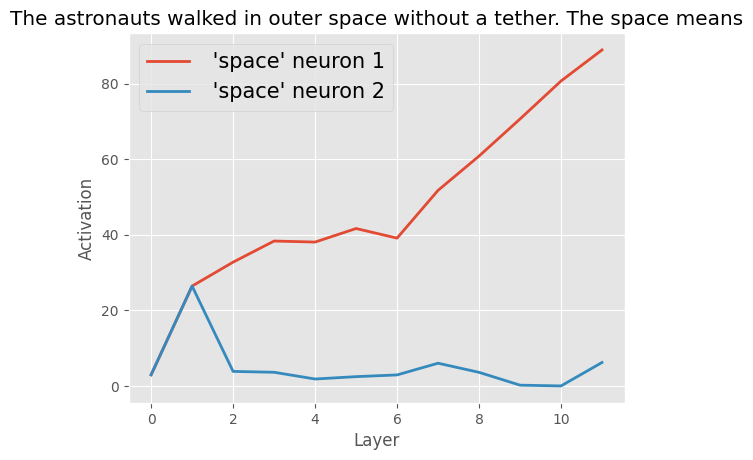

In [ ]:
# example_prompt = exp1["context_1"]
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"][c1_maxlist[l]])
        # display(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        # c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"][c2_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break
# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=" 'space' neuron 1", linewidth=2)
plt.plot(c2_act_list, label=" 'space' neuron 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(example_prompt)
plt.legend(fontsize=15)

#### context2

<ipython-input-19-7f114a623788>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-19-7f114a623788>:26: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



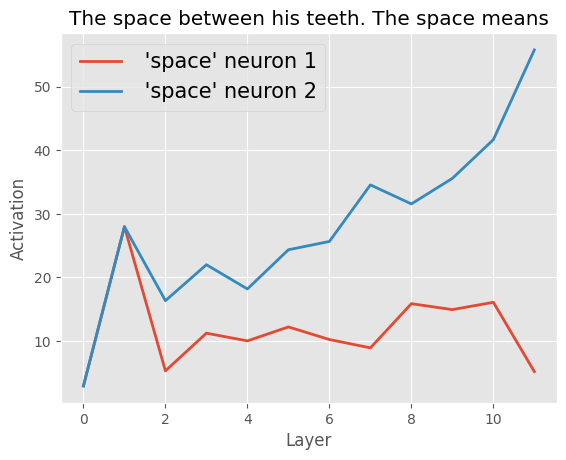

In [ ]:
# example_prompt = exp1["context_2"]
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"][c1_maxlist[l]])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        # c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"][c2_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break

# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=" 'space' neuron 1", linewidth=2)
plt.plot(c2_act_list, label=" 'space' neuron 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(example_prompt)
plt.legend(fontsize=15)

## [3-5] Logit Lens TopK visualization

#### context1 (space)

In [ ]:
c1_maxlist

[3119, 6781, 16032, 2591, 5168, 553, 14850, 22301, 6848, 16808, 17742, 24327]

In [ ]:
from sae_dashboard.sae_vis_data import SaeVisConfig
from sae_dashboard.sae_vis_runner import SaeVisRunner

# Reduce the number of top activations to find to avoid the error
# 14412, 9000, 592, 16971, 5292, 19598, 22553, 17601
test_feature_idx_gpt = c1_maxlist + c2_maxlist
feature_vis_config_gpt = SaeVisConfig(
    hook_point=sae8.cfg.hook_name,
    features=test_feature_idx_gpt,
    minibatch_size_features=10,
    minibatch_size_tokens=10,
    verbose=True,
    device=device,
    # top_acts_group_size=5 # Reduced from 10
)

# Convert the list to a PyTorch tensor
tokens_tensor = torch.tensor(model.tokenizer([template.format(context=exp1["context_1"], target_word=target_word) * 10])["input_ids"]).to(device)
print(tokens_tensor.shape)
visualization_data_gpt = SaeVisRunner(feature_vis_config_gpt).run(
    encoder=sae8, # type: ignore
    model=model,
    tokens=tokens_tensor,
    # cfg=feature_vis_config_gpt,
)
from sae_dashboard.data_writing_fns import save_feature_centric_vis

filename = f"demo_feature_dashboards.html"
save_feature_centric_vis(sae_vis_data=visualization_data_gpt, filename=filename)
display_vis_inline(filename)

torch.Size([1, 130])


Forward passes to cache data for vis:   0%|          | 0/3 [00:00<?, ?it/s]

Extracting vis data from cached data:   0%|          | 0/24 [00:00<?, ?it/s]

┏━━━━━━┳━━━━━━┳━━━━━━━┓
┃ Task ┃ Time ┃ Pct % ┃
┡━━━━━━╇━━━━━━╇━━━━━━━┩
└──────┴──────┴───────┘

Saving feature-centric vis:   0%|          | 0/22 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

Serving files from /content on port 6667


In [ ]:
# print(visualization_data_gpt.feature_data_dict[5168].logits_table_data)
top_k_tokens = visualization_data_gpt.feature_data_dict[6848].logits_table_data.top_token_ids
top_k_logits = visualization_data_gpt.feature_data_dict[6848].logits_table_data.top_logits
df = pd.DataFrame(top_k_logits, columns=["logits"])
# print(top_k_tokens)
for i in range(len(top_k_tokens)):
    # print(model.tokenizer.decode(top_k_tokens[i]), top_k_logits[i])
    df.loc[i, "tokens"] = model.tokenizer.decode(top_k_tokens[i])

display(df)

,logits,tokens
0,1.223861,flight
1,0.956770,plane
2,0.937604,shuttle
3,0.936815,gravity
4,0.919513,craft
5,0.876162,Engineers
6,0.869116,planes
7,0.861662,kat
8,0.842384,borne
9,0.838419,uits


#### context2 (space)

In [ ]:
c2_maxlist

[3119, 6781, 7685, 19836, 14412, 9000, 592, 16971, 5292, 19598, 22553, 17601]

In [ ]:
from sae_dashboard.sae_vis_data import SaeVisConfig
from sae_dashboard.sae_vis_runner import SaeVisRunner

# Reduce the number of top activations to find to avoid the error
# test_feature_idx_gpt = [6848] + [16032] + [6781] + [7685] + [2591] + [19836] + [14412] + [9000] + [592] + [16971] + [5292] + [19598] + [22553] + [17601]
test_feature_idx_gpt = c2_maxlist
feature_vis_config_gpt = SaeVisConfig(
    hook_point=sae8.cfg.hook_name,
    features=test_feature_idx_gpt,
    minibatch_size_features=10,
    minibatch_size_tokens=10,
    verbose=True,
    device=device,
    # top_acts_group_size=5 # Reduced from 10
)

# Convert the list to a PyTorch tensor
tokens_tensor = torch.tensor(model.tokenizer([template.format(context=exp1["context_2"], target_word=target_word) * 10])["input_ids"]).to(device)
visualization_data_gpt = SaeVisRunner(feature_vis_config_gpt).run(
    encoder=sae8, # type: ignore
    model=model,
    tokens=tokens_tensor,
    # cfg=feature_vis_config_gpt,
)
from sae_dashboard.data_writing_fns import save_feature_centric_vis

filename = f"demo_feature_dashboards.html"
save_feature_centric_vis(sae_vis_data=visualization_data_gpt, filename=filename)
display_vis_inline(filename)

Forward passes to cache data for vis:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting vis data from cached data:   0%|          | 0/12 [00:00<?, ?it/s]

┏━━━━━━┳━━━━━━┳━━━━━━━┓
┃ Task ┃ Time ┃ Pct % ┃
┡━━━━━━╇━━━━━━╇━━━━━━━┩
└──────┴──────┴───────┘

Saving feature-centric vis:   0%|          | 0/12 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

Serving files from /content on port 6669


In [ ]:
# print(visualization_data_gpt.feature_data_dict[5168].logits_table_data)
top_k_tokens = visualization_data_gpt.feature_data_dict[5292].logits_table_data.top_token_ids
top_k_logits = visualization_data_gpt.feature_data_dict[5292].logits_table_data.top_logits
df = pd.DataFrame(top_k_logits, columns=["logits"])
# print(top_k_tokens)
for i in range(len(top_k_tokens)):
    # print(model.tokenizer.decode(top_k_tokens[i]), top_k_logits[i])
    df.loc[i, "tokens"] = model.tokenizer.decode(top_k_tokens[i])

display(df)

,logits,tokens
0,0.894026,Layout
1,0.881799,occupied
2,0.852871,spaces
3,0.845883,vacated
4,0.825059,space
5,0.799214,shuttle
6,0.798153,occupancy
7,0.779821,Spaces
8,0.772643,dayName
9,0.753693,bars


<ipython-input-204-4010d56fc7be>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-204-4010d56fc7be>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



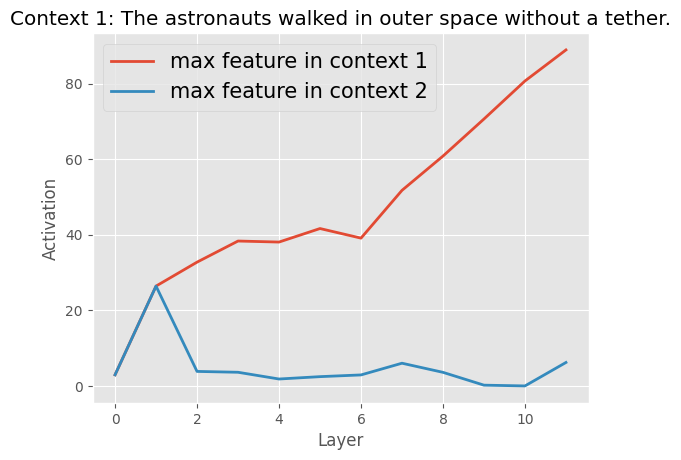

In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break

# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f"max feature in context 1", linewidth=2)
plt.plot(c2_act_list, label=f"max feature in context 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 1: {exp1['context_1']}")
plt.legend(fontsize=15)
plt.savefig(f"context1_{exp1['context_1']}.pdf")
plt.show()

<ipython-input-205-5f6005c754fa>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-205-5f6005c754fa>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



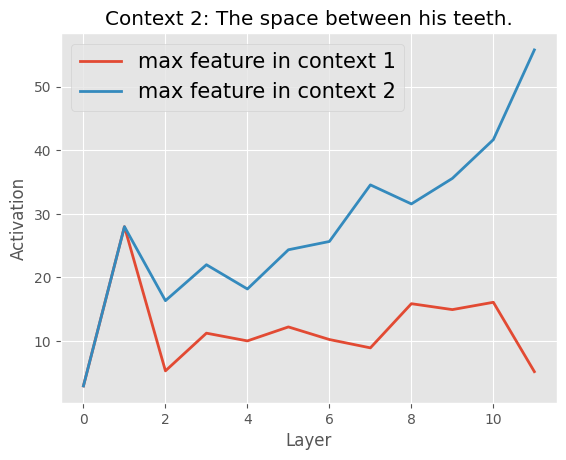

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break

# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f"max feature in context 1", linewidth=2)
plt.plot(c2_act_list, label=f"max feature in context 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 2: {exp1['context_2']}")
plt.legend(fontsize=15)
plt.savefig(f"context2_{exp1['context_2']}.pdf")
plt.show()

 ### Template Sensitivity

In [ ]:
template = "{target_word}"

In [ ]:
# example_prompt = exp1["context_1"]
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # display(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1])
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:],labels=dict(index="index", value="value"),).show()
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
# example_prompt = exp1["context_1"]
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"],labels=dict(index="index", value="value"),).show()
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:],labels=dict(index="index", value="value"),).show()
        # c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].argmax())
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:].argmax())
        break

Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
c1_maxlist

[22902,
 18918,
 16467,
 19836,
 14412,
 18798,
 9886,
 22301,
 6848,
 16808,
 17742,
 24327]

In [ ]:
from sae_dashboard.sae_vis_data import SaeVisConfig
from sae_dashboard.sae_vis_runner import SaeVisRunner

# Reduce the number of top activations to find to avoid the error
# 14412, 9000, 592, 16971, 5292, 19598, 22553, 17601
test_feature_idx_gpt = c1_maxlist
feature_vis_config_gpt = SaeVisConfig(
    hook_point=sae8.cfg.hook_name,
    features=test_feature_idx_gpt,
    minibatch_size_features=10,
    minibatch_size_tokens=10,
    verbose=True,
    device=device,
    # top_acts_group_size=5 # Reduced from 10
)

# Convert the list to a PyTorch tensor
tokens_tensor = torch.tensor(model.tokenizer([template.format(context=exp1["context_1"], target_word=target_word) * 100])["input_ids"]).to(device)
print(tokens_tensor.shape)
visualization_data_gpt = SaeVisRunner(feature_vis_config_gpt).run(
    encoder=sae8, # type: ignore
    model=model,
    tokens=tokens_tensor,
    # cfg=feature_vis_config_gpt,
)
from sae_dashboard.data_writing_fns import save_feature_centric_vis

filename = f"demo_feature_dashboards.html"
save_feature_centric_vis(sae_vis_data=visualization_data_gpt, filename=filename)
display_vis_inline(filename)

torch.Size([1, 101])


Forward passes to cache data for vis:   0%|          | 0/2 [00:00<?, ?it/s]

Extracting vis data from cached data:   0%|          | 0/12 [00:00<?, ?it/s]

┏━━━━━━┳━━━━━━┳━━━━━━━┓
┃ Task ┃ Time ┃ Pct % ┃
┡━━━━━━╇━━━━━━╇━━━━━━━┩
└──────┴──────┴───────┘

Saving feature-centric vis:   0%|          | 0/12 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

Serving files from /content on port 6668


## [3-6] Wic metric vis

### [3-6-1] Layer wise simrality

#### context1

In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
print(example_prompt)
max_enc_weights = []
max_dec_weights = []
for (layer_i, sae), max_ind in zip(enumerate(saes), c1_maxlist):
  print("-"*10)
  print("Layer ", layer_i)
  print("-"*10)

  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  max_enc_weight = sae.W_enc[:, max_ind]
  max_dec_weight = sae.W_dec[max_ind, :]
  # cos 類似度　torch
  cos_sim = torch.nn.functional.cosine_similarity(max_enc_weight, max_dec_weight, dim=0)
  print("enc dec cos sin", cos_sim)
  max_enc_weights.append(max_enc_weight)
  max_dec_weights.append(max_dec_weight)

# cos sim matrix
cos_sim_matrix_enc = torch.zeros(len(saes), len(saes))
for layer_i in range(len(saes)):
  for layer_j in range(len(saes)):
    cos_sim = torch.nn.functional.cosine_similarity(max_enc_weights[layer_i], max_enc_weights[layer_j], dim=0)
    cos_sim_matrix_enc[layer_i, layer_j] = cos_sim

cos_sim_matrix_dec = torch.zeros(len(saes), len(saes))
for layer_i in range(len(saes)):
  for layer_j in range(len(saes)):
    cos_sim = torch.nn.functional.cosine_similarity(max_dec_weights[layer_i], max_dec_weights[layer_j], dim=0)
    cos_sim_matrix_dec[layer_i, layer_j] = cos_sim

px.imshow(cos_sim_matrix_enc, title="W_enc cos similarity").show()
px.imshow(cos_sim_matrix_dec, title="W_dec cos similarity").show()


The astronauts walked in outer space without a tether. The space means
----------
Layer  0
----------
enc dec cos sin tensor(0.5390, device='cuda:0')
----------
Layer  1
----------
enc dec cos sin tensor(0.3150, device='cuda:0')
----------
Layer  2
----------
enc dec cos sin tensor(0.2687, device='cuda:0')
----------
Layer  3
----------
enc dec cos sin tensor(0.2774, device='cuda:0')
----------
Layer  4
----------
enc dec cos sin tensor(0.3107, device='cuda:0')
----------
Layer  5
----------
enc dec cos sin tensor(0.2832, device='cuda:0')
----------
Layer  6
----------
enc dec cos sin tensor(0.3032, device='cuda:0')
----------
Layer  7
----------
enc dec cos sin tensor(0.3179, device='cuda:0')
----------
Layer  8
----------
enc dec cos sin tensor(0.3203, device='cuda:0')
----------
Layer  9
----------
enc dec cos sin tensor(0.3191, device='cuda:0')
----------
Layer  10
----------
enc dec cos sin tensor(0.3301, device='cuda:0')
----------
Layer  11
----------
enc dec cos sin tensor(0.32

#### context2

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
print(example_prompt)
max_enc_weights = []
max_dec_weights = []
for (layer_i, sae), max_ind in zip(enumerate(saes), c2_maxlist):
  print("-"*10)
  print("Layer ", layer_i)
  print("-"*10)

  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  max_enc_weight = sae.W_enc[:, max_ind]
  max_dec_weight = sae.W_dec[max_ind, :]
  # cos 類似度　torch
  cos_sim = torch.nn.functional.cosine_similarity(max_enc_weight, max_dec_weight, dim=0)
  print("enc dec cos sin", cos_sim)
  max_enc_weights.append(max_enc_weight)
  max_dec_weights.append(max_dec_weight)

# cos sim matrix
cos_sim_matrix_enc = torch.zeros(len(saes), len(saes))
for layer_i in range(len(saes)):
  for layer_j in range(len(saes)):
    cos_sim = torch.nn.functional.cosine_similarity(max_enc_weights[layer_i], max_enc_weights[layer_j], dim=0)
    cos_sim_matrix_enc[layer_i, layer_j] = cos_sim

cos_sim_matrix_dec = torch.zeros(len(saes), len(saes))
for layer_i in range(len(saes)):
  for layer_j in range(len(saes)):
    cos_sim = torch.nn.functional.cosine_similarity(max_dec_weights[layer_i], max_dec_weights[layer_j], dim=0)
    cos_sim_matrix_dec[layer_i, layer_j] = cos_sim

px.imshow(cos_sim_matrix_enc, title="W_enc cos similarity").show()
px.imshow(cos_sim_matrix_dec, title="W_dec cos similarity").show()


The space between his teeth. The space means
----------
Layer  0
----------
enc dec cos sin tensor(0.5390, device='cuda:0')
----------
Layer  1
----------
enc dec cos sin tensor(0.3150, device='cuda:0')
----------
Layer  2
----------
enc dec cos sin tensor(0.2997, device='cuda:0')
----------
Layer  3
----------
enc dec cos sin tensor(0.3012, device='cuda:0')
----------
Layer  4
----------
enc dec cos sin tensor(0.3196, device='cuda:0')
----------
Layer  5
----------
enc dec cos sin tensor(0.3011, device='cuda:0')
----------
Layer  6
----------
enc dec cos sin tensor(0.3084, device='cuda:0')
----------
Layer  7
----------
enc dec cos sin tensor(0.3385, device='cuda:0')
----------
Layer  8
----------
enc dec cos sin tensor(0.3336, device='cuda:0')
----------
Layer  9
----------
enc dec cos sin tensor(0.3314, device='cuda:0')
----------
Layer  10
----------
enc dec cos sin tensor(0.3538, device='cuda:0')
----------
Layer  11
----------
enc dec cos sin tensor(0.3328, device='cuda:0')


#### [3-6-2] Context-wise Simirality

In [ ]:
example_prompt1 = template.format(context=exp1["context_1"], target_word=target_word)
example_prompt2 = template.format(context=exp1["context_2"], target_word=target_word)
print(example_prompt)
max_enc_weights1 = []
max_dec_weights1 = []
max_enc_weights2 = []
max_dec_weights2 = []
for (layer_i, sae), (max_ind1, max_ind2) in zip(enumerate(saes), zip(c1_maxlist, c2_maxlist)):
  print("-"*10)
  print("Layer ", layer_i)
  print("-"*10)

  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  max_enc_weight1 = sae.W_enc[:, max_ind1]
  max_dec_weight1 = sae.W_dec[max_ind1, :]
  max_enc_weight2 = sae.W_enc[:, max_ind2]
  max_dec_weight2 = sae.W_dec[max_ind2, :]
  # cos 類似度　torch
  cos_sim = torch.nn.functional.cosine_similarity(max_enc_weight1, max_dec_weight2, dim=0)
  print("enc dec cos sin", cos_sim)
  max_enc_weights1.append(max_enc_weight1)
  max_enc_weights2.append(max_enc_weight2)
  max_dec_weights1.append(max_dec_weight1)
  max_dec_weights2.append(max_dec_weight2)

# cos sim matrix
cos_sim_matrix_enc = torch.zeros(len(saes), len(saes))
for layer_i in range(len(saes)):
  for layer_j in range(len(saes)):
    cos_sim = torch.nn.functional.cosine_similarity(max_enc_weights1[layer_i], max_enc_weights2[layer_j], dim=0)
    cos_sim_matrix_enc[layer_i, layer_j] = cos_sim

cos_sim_matrix_dec = torch.zeros(len(saes), len(saes))
for layer_i in range(len(saes)):
  for layer_j in range(len(saes)):
    cos_sim = torch.nn.functional.cosine_similarity(max_dec_weights1[layer_i], max_dec_weights2[layer_j], dim=0)
    cos_sim_matrix_dec[layer_i, layer_j] = cos_sim

px.imshow(cos_sim_matrix_enc, title="W_enc cos similarity").show()
px.imshow(cos_sim_matrix_dec, title="W_dec cos similarity").show()


The space between his teeth. The space means
----------
Layer  0
----------
enc dec cos sin tensor(0.5390, device='cuda:0')
----------
Layer  1
----------
enc dec cos sin tensor(0.3150, device='cuda:0')
----------
Layer  2
----------
enc dec cos sin tensor(0.0388, device='cuda:0')
----------
Layer  3
----------
enc dec cos sin tensor(0.0511, device='cuda:0')
----------
Layer  4
----------
enc dec cos sin tensor(0.0639, device='cuda:0')
----------
Layer  5
----------
enc dec cos sin tensor(0.0691, device='cuda:0')
----------
Layer  6
----------
enc dec cos sin tensor(0.0860, device='cuda:0')
----------
Layer  7
----------
enc dec cos sin tensor(0.1043, device='cuda:0')
----------
Layer  8
----------
enc dec cos sin tensor(0.1182, device='cuda:0')
----------
Layer  9
----------
enc dec cos sin tensor(0.1106, device='cuda:0')
----------
Layer  10
----------
enc dec cos sin tensor(0.1121, device='cuda:0')
----------
Layer  11
----------
enc dec cos sin tensor(0.1152, device='cuda:0')


## Another example (save)

In [ ]:
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
exp1 = wic_dataset["train"][312]
exp1["context_2"] = "She save the old family photographs in a drawer."
print(exp1["context_1"])
print(exp1["context_2"])
target_word = exp1["target_word"]
print(target_word)

This will save you a lot of time.
She save the old family photographs in a drawer.
save


In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
print(example_prompt)
import plotly.express as px
import matplotlib.pyplot as plt
c1_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

This will save you a lot of time. The save means
Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
id = 7685
_3119_list = []
c2_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break


Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


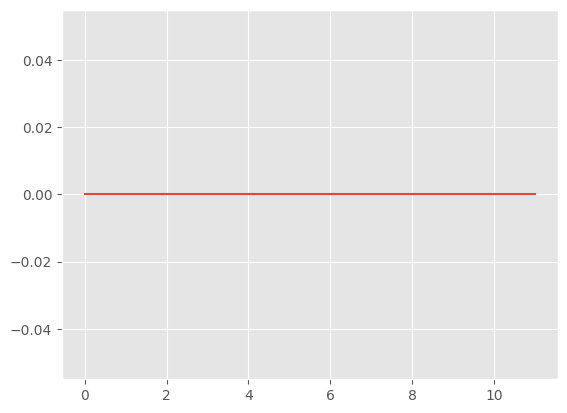

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        break
plt.plot(_3119_list)

In [ ]:
c1_maxlist

[16830,
 20392,
 11504,
 18408,
 5588,
 16461,
 7283,
 11242,
 13948,
 19122,
 14712,
 11548]

In [ ]:
c2_maxlist

[16830,
 20392,
 11504,
 15141,
 5588,
 15190,
 7283,
 11242,
 13948,
 19122,
 14712,
 11548]

In [ ]:
from sae_dashboard.sae_vis_data import SaeVisConfig
from sae_dashboard.sae_vis_runner import SaeVisRunner

# Reduce the number of top activations to find to avoid the error
# 14412, 9000, 592, 16971, 5292, 19598, 22553, 17601
test_feature_idx_gpt = c1_maxlist + c2_maxlist
feature_vis_config_gpt = SaeVisConfig(
    hook_point=sae5.cfg.hook_name,
    features=test_feature_idx_gpt,
    minibatch_size_features=10,
    minibatch_size_tokens=10,
    verbose=True,
    device=device,
    # top_acts_group_size=5 # Reduced from 10
)

# Convert the list to a PyTorch tensor
tokens_tensor = torch.tensor(model.tokenizer([template.format(context=exp1["context_2"], target_word=target_word) * 10])["input_ids"]).to(device)
visualization_data_gpt = SaeVisRunner(feature_vis_config_gpt).run(
    encoder=sae5, # type: ignore
    model=model,
    tokens=tokens_tensor,
    # cfg=feature_vis_config_gpt,
)
from sae_dashboard.data_writing_fns import save_feature_centric_vis

filename = f"demo_feature_dashboards.html"
save_feature_centric_vis(sae_vis_data=visualization_data_gpt, filename=filename)
display_vis_inline(filename)

Forward passes to cache data for vis:   0%|          | 0/3 [00:00<?, ?it/s]

Extracting vis data from cached data:   0%|          | 0/24 [00:00<?, ?it/s]

┏━━━━━━┳━━━━━━┳━━━━━━━┓
┃ Task ┃ Time ┃ Pct % ┃
┡━━━━━━╇━━━━━━╇━━━━━━━┩
└──────┴──────┴───────┘

Saving feature-centric vis:   0%|          | 0/14 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

Serving files from /content on port 6701


In [ ]:
# print(visualization_data_gpt.feature_data_dict[5168].logits_table_data)
top_k_tokens = visualization_data_gpt.feature_data_dict[15190].logits_table_data.top_token_ids
top_k_logits = visualization_data_gpt.feature_data_dict[15190].logits_table_data.top_logits
df = pd.DataFrame(top_k_logits, columns=["logits"])
# print(top_k_tokens)
for i in range(len(top_k_tokens)):
    # print(model.tokenizer.decode(top_k_tokens[i]), top_k_logits[i])
    df.loc[i, "tokens"] = model.tokenizer.decode(top_k_tokens[i])

display(df)

,logits,tokens
0,0.873687,闘
1,0.743873,Cache
2,0.731151,TOR
3,0.664540,Marcos
4,0.658139,Sanctuary
5,0.649393,Save
6,0.644051,orage
7,0.640152,Save
8,0.626904,Shelter
9,0.611833,Deposit


<ipython-input-190-7d440336b3af>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-190-7d440336b3af>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



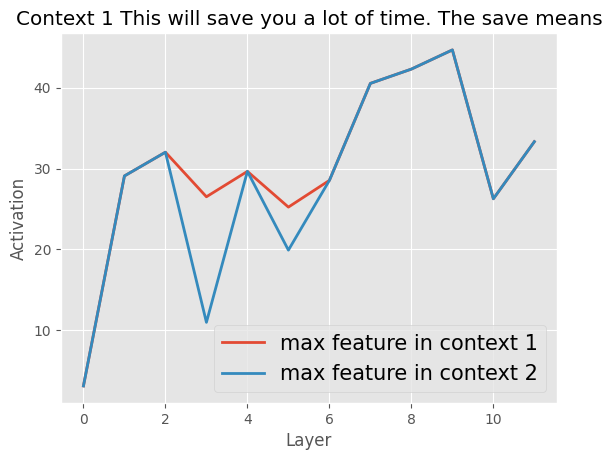

In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break
# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f"max feature in context 1", linewidth=2)
plt.plot(c2_act_list, label=f"max feature in context 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 1 {example_prompt}")
plt.legend(fontsize=15)
plt.savefig(f"context1_{example_prompt}.pdf")

<ipython-input-191-ad4a00288c02>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-191-ad4a00288c02>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



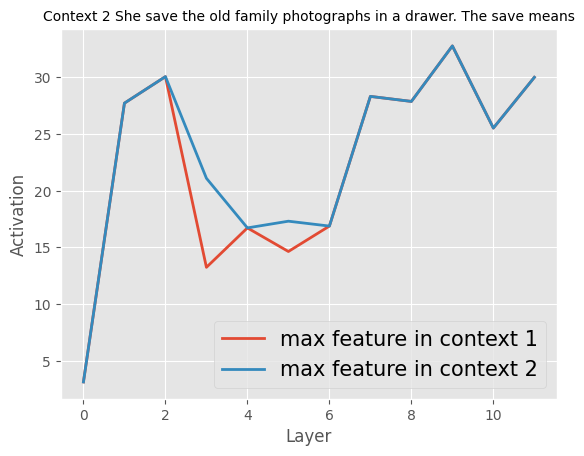

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break

# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f"max feature in context 1", linewidth=2)
plt.plot(c2_act_list, label=f"max feature in context 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 2 {example_prompt}", fontsize=10)
plt.legend(fontsize=15)
plt.savefig(f"context2_{example_prompt}.pdf")

## Another (ball)

In [ ]:
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
exp1 = wic_dataset["train"][648]
print(exp1["context_1"])
print(exp1["context_2"])
target_word = exp1["target_word"]
print(target_word)

The ball was already emptying out before the fire alarm sounded.
The ball rolled into the corner pocket.
ball


In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        print(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"])
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break


Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]


In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c2_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        # px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        print(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
        print(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"])
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------
 ball
        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------
 ball
        ball   ball
0        0.0    0.0
1        0.0    0.0
2        0.0    0.0
3        0.0    0.0
4        0.0    0.0
...      ...    ...
24571    0.0    0.0
24572    0.0    0.0
24573    0.0    0.0
24574    0.0    0.0
24575    0.0    0.0

[24576 rows x 2 columns]
Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------
 ball
        ball   ball
0        0.0    0.0
1        0.0    0

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
print(c1_maxlist, c2_maxlist)

[1881, 17674, 18209, 16582, 12054, 14555, 9801, 21236, 21046, 6414, 4150, 21021] [1881, 17674, 18209, 16582, 17912, 14555, 9801, 6828, 21046, 18210, 6752, 11522]


In [ ]:
from sae_dashboard.sae_vis_data import SaeVisConfig
from sae_dashboard.sae_vis_runner import SaeVisRunner

# Reduce the number of top activations to find to avoid the error
# 14412, 9000, 592, 16971, 5292, 19598, 22553, 17601
test_feature_idx_gpt = c1_maxlist + c2_maxlist
feature_vis_config_gpt = SaeVisConfig(
    hook_point=sae7.cfg.hook_name,
    features=test_feature_idx_gpt,
    minibatch_size_features=10,
    minibatch_size_tokens=10,
    verbose=True,
    device=device,
    # top_acts_group_size=5 # Reduced from 10
)

# Convert the list to a PyTorch tensor
tokens_tensor = torch.tensor(model.tokenizer([template.format(context=exp1["context_1"], target_word=target_word) * 10])["input_ids"]).to(device)
visualization_data_gpt = SaeVisRunner(feature_vis_config_gpt).run(
    encoder=sae7, # type: ignore
    model=model,
    tokens=tokens_tensor,
    # cfg=feature_vis_config_gpt,
)
from sae_dashboard.data_writing_fns import save_feature_centric_vis

filename = f"demo_feature_dashboards.html"
save_feature_centric_vis(sae_vis_data=visualization_data_gpt, filename=filename)
display_vis_inline(filename)

Forward passes to cache data for vis:   0%|          | 0/3 [00:00<?, ?it/s]

Extracting vis data from cached data:   0%|          | 0/24 [00:00<?, ?it/s]

┏━━━━━━┳━━━━━━┳━━━━━━━┓
┃ Task ┃ Time ┃ Pct % ┃
┡━━━━━━╇━━━━━━╇━━━━━━━┩
└──────┴──────┴───────┘

Saving feature-centric vis:   0%|          | 0/17 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

Serving files from /content on port 6701


In [ ]:
# print(visualization_data_gpt.feature_data_dict[5168].logits_table_data)
top_k_tokens = visualization_data_gpt.feature_data_dict[21236].logits_table_data.top_token_ids
top_k_logits = visualization_data_gpt.feature_data_dict[21236].logits_table_data.top_logits
df = pd.DataFrame(top_k_logits, columns=["logits"])
# print(top_k_tokens)
for i in range(len(top_k_tokens)):
    # print(model.tokenizer.decode(top_k_tokens[i]), top_k_logits[i])
    df.loc[i, "tokens"] = model.tokenizer.decode(top_k_tokens[i])

display(df)

,logits,tokens
0,1.170216,oons
1,1.114579,istics
2,1.025519,oon
3,1.007992,antine
4,0.975114,park
5,0.960103,asso
6,0.905391,asted
7,0.900819,ball
8,0.888260,istically
9,0.886209,haus


<ipython-input-179-173574936c30>:22: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-179-173574936c30>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



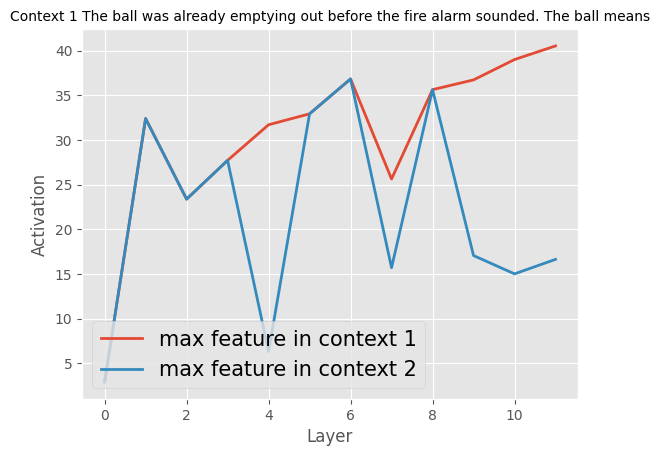

In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break
# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f"max feature in context 1", linewidth=2)
plt.plot(c2_act_list, label=f"max feature in context 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 1 {example_prompt}", fontsize=10)
plt.legend(fontsize=15, loc="lower left")
plt.savefig("ball_context1.pdf")

<ipython-input-180-64cfe6b20805>:22: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-180-64cfe6b20805>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



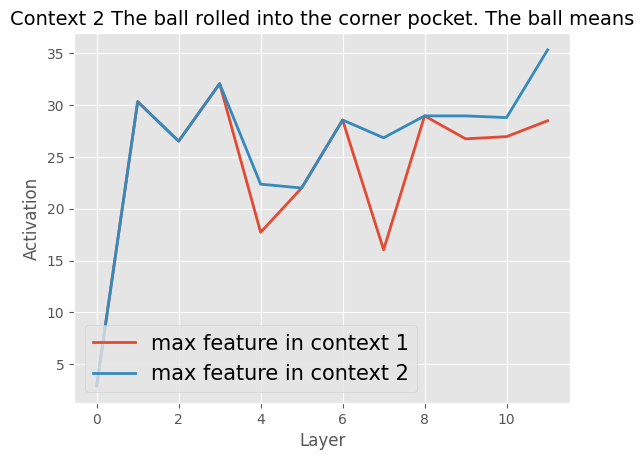

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break
# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f"max feature in context 1", linewidth=2)
plt.plot(c2_act_list, label=f"max feature in context 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 2 {example_prompt}", fontsize=14)
plt.legend(fontsize=15, loc="lower left")
plt.savefig("ball_context2.pdf")

## Another example (space) same meanings

In [ ]:
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
# target_word == "space"
exp1_df = pd.DataFrame(wic_dataset["train"])
exp1_df = exp1_df[exp1_df["target_word"] == "space"]
exp1_df

,id,context_1,context_2,target_word,pos,target_word_location_1,target_word_location_2,language,label
22,EN_22,They stopped at an open space in the jungle.,The astronauts walked in outer space without a...,space,N,"{'char_start': 24, 'char_end': 29}","{'char_start': 31, 'char_end': 36}",EN,0
51,EN_51,The astronauts walked in outer space without a...,The space between his teeth.,space,N,"{'char_start': 31, 'char_end': 36}","{'char_start': 4, 'char_end': 9}",EN,0
140,EN_140,They stopped at an open space in the jungle.,They tested his ability to locate objects in s...,space,N,"{'char_start': 24, 'char_end': 29}","{'char_start': 45, 'char_end': 50}",EN,0
223,EN_223,They stopped at an open space in the jungle.,The space between his teeth.,space,N,"{'char_start': 24, 'char_end': 29}","{'char_start': 4, 'char_end': 9}",EN,1
501,EN_501,They tested his ability to locate objects in s...,Write your name in the space provided.,space,N,"{'char_start': 45, 'char_end': 50}","{'char_start': 23, 'char_end': 28}",EN,0
677,EN_677,The space between his teeth.,The architect left space in front of the build...,space,N,"{'char_start': 4, 'char_end': 9}","{'char_start': 19, 'char_end': 24}",EN,1
905,EN_905,They tested his ability to locate objects in s...,Functional analysis is best approached through...,space,N,"{'char_start': 45, 'char_end': 50}","{'char_start': 76, 'char_end': 81}",EN,1
1121,EN_1121,They tested his ability to locate objects in s...,The spaces are the notes F-A-C-E.,space,N,"{'char_start': 45, 'char_end': 50}","{'char_start': 4, 'char_end': 10}",EN,0
1833,EN_1833,They stopped at an open space in the jungle.,It all happened in the space of 10 minutes.,space,N,"{'char_start': 24, 'char_end': 29}","{'char_start': 23, 'char_end': 28}",EN,0
2356,EN_2356,It all happened in the space of 10 minutes.,The architect left space in front of the build...,space,N,"{'char_start': 23, 'char_end': 28}","{'char_start': 19, 'char_end': 24}",EN,0


In [ ]:
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
exp1 = wic_dataset["train"][223]
print(exp1["context_1"])
print(exp1["context_2"])
target_word = exp1["target_word"]
print(target_word)

They stopped at an open space in the jungle.
The space between his teeth.
space


In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
id = 2591
_3119_list = []
c1_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        break


Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
id = 7685
_3119_list = []
c2_maxlist = []
for sae in saes[:4]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        break

Layer blocks.0.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.1.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.2.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.3.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.4.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.5.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.6.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.7.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.8.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.9.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.10.hook_resid_pre
----------------------------------------------------------------------------------------------------


Layer blocks.11.hook_resid_pre
----------------------------------------------------------------------------------------------------


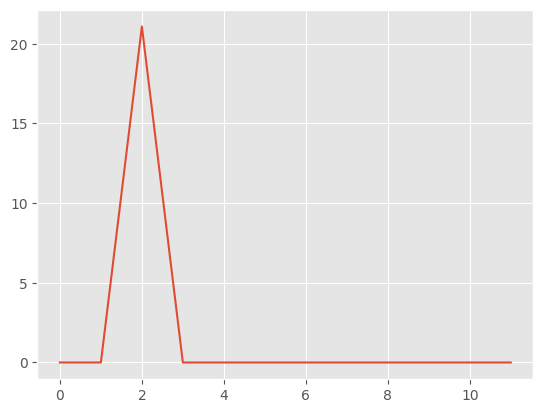

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
for sae in saes[4:]:
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  # display(df)
  print("Layer", sae.cfg.hook_name)
  print("-"*100)
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        px.scatter(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1],labels=dict(index="index", value="value"),).show()
        c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        break
plt.plot(_3119_list)

<ipython-input-45-ce07fe1af2e0>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-45-ce07fe1af2e0>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



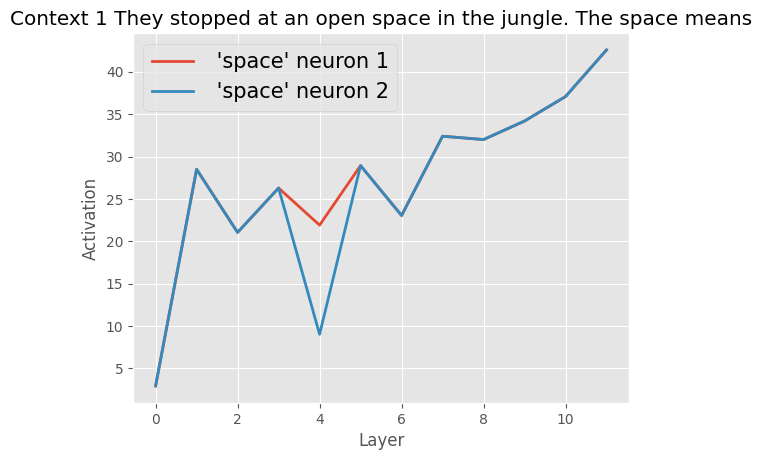

In [ ]:
example_prompt = template.format(context=exp1["context_1"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break

# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f" '{target_word}' neuron 1", linewidth=2)
plt.plot(c2_act_list, label=f" '{target_word}' neuron 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 1 {example_prompt}")
plt.legend(fontsize=15)

<ipython-input-46-866932ff6ba5>:23: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-46-866932ff6ba5>:24: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



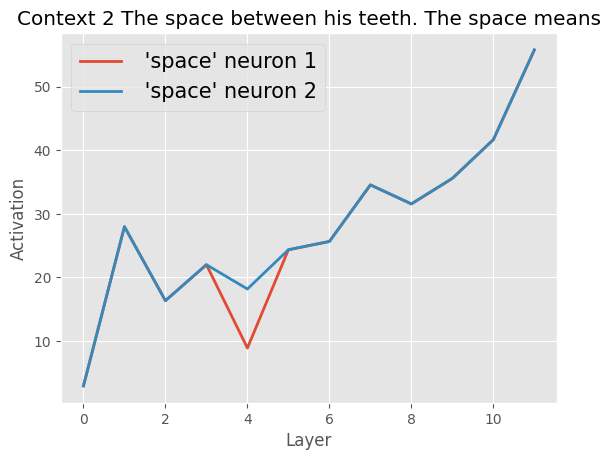

In [ ]:
example_prompt = template.format(context=exp1["context_2"], target_word=target_word)
import plotly.express as px
import matplotlib.pyplot as plt
c1_act_list = []
c2_act_list = []
for l, sae in enumerate(saes):
  logits, cache = model.run_with_cache(example_prompt, prepend_bos=True)
  tokens = model.to_tokens(example_prompt)
  sae_out = sae(cache[sae.cfg.hook_name])
  sae_act = sae.encode(cache[sae.cfg.hook_name])

  import pandas as pd
  df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
  for i in range(1, sae_act.shape[1]):
      df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
  df.columns = [f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
  df.index = [f"{i}" for i in range(sae_act.shape[-1])]
  for i in range(1, sae_act.shape[1]):
    # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}", alpha=0.5, color="blue")
    # plt.title(model.to_str_tokens(example_prompt, prepend_bos=True)[i])
    if target_word in model.to_str_tokens(example_prompt, prepend_bos=True)[i]:
        _3119_list.append(sae_act.cpu().numpy()[0][i][id])
        c1_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c1_maxlist[l]])
        c2_act_list.append(df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"].iloc[:, -1][c2_maxlist[l]])
        break

# plt style
plt.style.use('ggplot')
plt.plot(c1_act_list, label=f" '{target_word}' neuron 1", linewidth=2)
plt.plot(c2_act_list, label=f" '{target_word}' neuron 2", linewidth=2)
plt.ylabel("Activation")
plt.xlabel("Layer")
plt.title(f"Context 2 {example_prompt}")
plt.legend(fontsize=15)

# [4] PS-Eval evaluation

In [ ]:
def calc_diag(exp):
  # define target sentence and word
  target_word = exp["target_word"]
  example_prompt1 = template.format(context=exp["context_1"], target_word=target_word)
  example_prompt2 = template.format(context=exp["context_2"], target_word=target_word)

  # get max sea feature index in each context
  c1_maxlist = []
  c2_maxlist = []
  # in context1
  tokens1 = model.to_tokens(example_prompt1)[0]
  to_str_tokens1 = model.to_str_tokens(example_prompt1, prepend_bos=True)
  if " " + target_word in to_str_tokens1:
    id_target_word1 = [i for i, x in enumerate(to_str_tokens1) if x == " " + target_word][-1]
    # print("id_target_word1", id_target_word1)
  else:
    print("Not found target word in context1")
    return None
  target_word_token1 = tokens1[id_target_word1]
  # in context2
  token2 = model.to_tokens(example_prompt2)[0]
  to_str_tokens2 = model.to_str_tokens(example_prompt2, prepend_bos=True)
  if " " + target_word in to_str_tokens2:
    id_target_word2 = [i for i, x in enumerate(to_str_tokens2) if x == " " + target_word][-1]
    # print("id_target_word2", id_target_word2)
  else:
    print("Not found target word in context2")
    return None
  target_word_token2 = token2[id_target_word2]

  # check target word in both contexts
  if target_word_token1 != target_word_token2:
    print("not same toknen in both contexts")
    return None

  # get max sea feature index in context1
  for sae in saes:
    logits, cache = model.run_with_cache(example_prompt1, prepend_bos=True)
    tokens = model.to_tokens(example_prompt1)
    sae_out = sae(cache[sae.cfg.hook_name])
    sae_act = sae.encode(cache[sae.cfg.hook_name])

    import pandas as pd
    df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
    for i in range(1, sae_act.shape[1]):
        df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
    df.columns = [f"{model.to_str_tokens(example_prompt1, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
    df.index = [f"{i}" for i in range(sae_act.shape[-1])]
    for i in range(1, sae_act.shape[1]):
      # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model
      if target_word in model.to_str_tokens(example_prompt1, prepend_bos=True)[i]:
         try:
          c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt1, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
          break
         except:
          print("error")
          return None

  # get max sea feature index in context2
  for sae in saes:
    logits, cache = model.run_with_cache(example_prompt2, prepend_bos=True)
    tokens = model.to_tokens(example_prompt2)
    sae_out = sae(cache[sae.cfg.hook_name])
    sae_act = sae.encode(cache[sae.cfg.hook_name])

    import pandas as pd
    df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
    for i in range(1, sae_act.shape[1]):
        df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
    df.columns = [f"{model.to_str_tokens(example_prompt2, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
    df.index = [f"{i}" for i in range(sae_act.shape[-1])]
    for i in range(1, sae_act.shape[1]):
      # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model
      if target_word in model.to_str_tokens(example_prompt2, prepend_bos=True)[i]:
         try:
          c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt2, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
          break

         except:
          print("error")
          return None

  # check same length
  if len(c1_maxlist) != len(c2_maxlist) and len(c1_maxlist) != len(saes):
    print("Not same length")
    return None

  # get weight cos sim
  max_enc_weights1 = []
  max_dec_weights1 = []
  max_enc_weights2 = []
  max_dec_weights2 = []

  for (layer_i, sae), (max_ind1, max_ind2) in zip(enumerate(saes), zip(c1_maxlist, c2_maxlist)):
    max_enc_weight1 = sae.W_enc[:, max_ind1]
    max_dec_weight1 = sae.W_dec[max_ind1, :]
    max_enc_weight2 = sae.W_enc[:, max_ind2]
    max_dec_weight2 = sae.W_dec[max_ind2, :]
    # cos sim　torch
    cos_sim = torch.nn.functional.cosine_similarity(max_enc_weight1, max_dec_weight2, dim=0)
    max_enc_weights1.append(max_enc_weight1)
    max_enc_weights2.append(max_enc_weight2)
    max_dec_weights1.append(max_dec_weight1)
    max_dec_weights2.append(max_dec_weight2)

  # cos sim matrix
  cos_sim_matrix_enc = torch.zeros(len(saes), len(saes))

  # check same length
  if not( len(max_enc_weights1) == len(max_enc_weights2) == len(saes)):
    print("Not same length")
    return None

  for layer_i in range(len(saes)):
    for layer_j in range(len(saes)):
      cos_sim = torch.nn.functional.cosine_similarity(max_enc_weights1[layer_i], max_enc_weights2[layer_j], dim=0)
      cos_sim_matrix_enc[layer_i, layer_j] = cos_sim

  cos_sim_matrix_dec = torch.zeros(len(saes), len(saes))
  for layer_i in range(len(saes)):
    for layer_j in range(len(saes)):
      cos_sim = torch.nn.functional.cosine_similarity(max_dec_weights1[layer_i], max_dec_weights2[layer_j], dim=0)
      cos_sim_matrix_dec[layer_i, layer_j] = cos_sim

  # 対角成分
  cos_sim_matrix_enc_diag = torch.diag(cos_sim_matrix_enc)
  cos_sim_matrix_dec_diag = torch.diag(cos_sim_matrix_dec)
  # px.line(cos_sim_matrix_enc_diag, title="W

  return cos_sim_matrix_enc_diag, cos_sim_matrix_dec_diag

def calc_f_value(exp):
  # define target sentence and word
  target_word = exp["target_word"]
  example_prompt1 = template.format(context=exp["context_1"], target_word=target_word)
  example_prompt2 = template.format(context=exp["context_2"], target_word=target_word)

  # get max sea feature index in each context
  c1_maxlist = []
  c2_maxlist = []
  tokens1 = model.to_tokens(example_prompt1)[0]
  to_str_tokens1 = model.to_str_tokens(example_prompt1, prepend_bos=True)
  if " " + target_word in to_str_tokens1:
    id_target_word1 = [i for i, x in enumerate(to_str_tokens1) if x == " " + target_word][-1]
    # print("id_target_word1", id_target_word1)
  else:
    print("not found")
    return None
  target_word_token1 = tokens1[id_target_word1]
  token2 = model.to_tokens(example_prompt2)[0]
  to_str_tokens2 = model.to_str_tokens(example_prompt2, prepend_bos=True)
  if " " + target_word in to_str_tokens2:
    id_target_word2 = [i for i, x in enumerate(to_str_tokens2) if x == " " + target_word][-1]
    # print("id_target_word2", id_target_word2)
  else:
    print("not found")
    return None
  target_word_token2 = token2[id_target_word2]
  if target_word_token1 != target_word_token2:
    print("not same toknen")
    return None
  for sae in saes:
    logits, cache = model.run_with_cache(example_prompt1, prepend_bos=True)
    tokens = model.to_tokens(example_prompt1)
    sae_out = sae(cache[sae.cfg.hook_name])
    sae_act = sae.encode(cache[sae.cfg.hook_name])

    import pandas as pd
    df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
    for i in range(1, sae_act.shape[1]):
        df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
    df.columns = [f"{model.to_str_tokens(example_prompt1, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
    df.index = [f"{i}" for i in range(sae_act.shape[-1])]
    for i in range(1, sae_act.shape[1]):
      if target_word in model.to_str_tokens(example_prompt1, prepend_bos=True)[i]:
         try:
          c1_maxlist.append(df[f"{model.to_str_tokens(example_prompt1, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
          break
         except:
          print("error")
          return None

  for sae in saes:
    logits, cache = model.run_with_cache(example_prompt2, prepend_bos=True)
    tokens = model.to_tokens(example_prompt2)
    sae_out = sae(cache[sae.cfg.hook_name])
    sae_act = sae.encode(cache[sae.cfg.hook_name])

    import pandas as pd
    df = pd.DataFrame(sae_act.cpu().numpy()[0][0])
    for i in range(1, sae_act.shape[1]):
        df = pd.concat([df, pd.DataFrame(sae_act.cpu().numpy()[0][i])], axis=1)
    df.columns = [f"{model.to_str_tokens(example_prompt2, prepend_bos=True)[i]}" for i in range(sae_act.shape[1])]
    df.index = [f"{i}" for i in range(sae_act.shape[-1])]
    for i in range(1, sae_act.shape[1]):
      # plt.scatter(range(sae_act.shape[-1]), df[f"{model.to_str_tokens(example_prompt, prepend_bos=True)[i]}"], label=f"{model
      if target_word in model.to_str_tokens(example_prompt2, prepend_bos=True)[i]:
         try:
          c2_maxlist.append(df[f"{model.to_str_tokens(example_prompt2, prepend_bos=True)[i]}"].iloc[:, -1].argmax())
          break

         except:
          print("error")
          return None

  if len(c1_maxlist) != len(c2_maxlist) and len(c1_maxlist) != len(saes):
    print("Not same length")
    return None

  same_num = np.zeros(len(c1_maxlist))
  for i in range(len(c1_maxlist)):
    if c1_maxlist[i] == c2_maxlist[i]:
      same_num[i] = 1

  return  same_num


### [4-1] F-value, Recall Precision Accuracy

#### label0

In [ ]:
# wic dataset label==0
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
exp1_df = pd.DataFrame(wic_dataset["train"])
exp1_df = exp1_df[exp1_df["label"] == 0]
fp_list = []
tn_list = []
cnt = 0
for i in range(len(exp1_df)):
    exp1 = exp1_df.iloc[i]
    FP = calc_f_value(exp1)
    if FP is not None:
      fp_list.append(FP)
      TN = 1 - FP
      tn_list.append(TN)
      cnt+=1
print("-------- data num --------")
print(cnt)
print("--------------------------")
print(np.sum(fp_list, axis=0))
print(np.sum(tn_list, axis=0))

error
error
error
error
error
error
error
error
not found
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
not found
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
not found
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
not found
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error


#### label1

In [ ]:
# wic dataset label==0
wic_dataset = load_dataset("pasinit/xlwic", "xlwic_en_de")
exp1_df = pd.DataFrame(wic_dataset["train"])
exp1_df = exp1_df[exp1_df["label"] == 1]
fn_list = []
tp_list = []
cnt = 0
for i in range(len(exp1_df)):
    exp1 = exp1_df.iloc[i]
    TP = calc_f_value(exp1)
    if TP is not None:
      tp_list.append(TP)
      FN = 1 - TP
      fn_list.append(FN)
      cnt+=1
print("-------- data num --------")
print(cnt)
print("--------------------------")
print(np.sum(fp_list, axis=0))
print(np.sum(tn_list, axis=0))

Recall and Precision

In [ ]:
tp = np.sum(tp_list)
fp = np.sum(fp_list)
tn = np.sum(tn_list)
fn = np.sum(fn_list)
print("TP", tp)
print("FP", fp)
print("TN", tn)
print("FN", fn)
f_value =  (2*tp)/(2*tp + fp + fn)
print("f_value", f_value)
recall = tp/(tp+fn)
precision = tp/(tp+fp)
print("recall", recall)
print("precision", precision)

In [ ]:
tp = np.sum(tp_list, axis=0)
fp = np.sum(fp_list, axis=0)
tn = np.sum(tn_list, axis=0)
fn = np.sum(fn_list, axis=0)
df = pd.DataFrame([tp.T, fp.T, tn.T, fn.T], index=["TP", "FP", "TN", "FN"])
df = df.T
# df["recall"] = df["tp"]/(df["tp"]+df["fn"])
# df["precision"] = df["tp"]/(df["tp"]+df["fp"])
# df["f_value"] =  (2*df["tp"])/(2*df["tp"] + df["fp"] + df["fn"])
df.plot.bar()
plt.ylabel("Metrics")
plt.xlabel("Layer")
# plt.title(f"Context 1 {example_prompt}")
plt.legend(fontsize=15)

In [ ]:
tp = np.sum(tp_list, axis=0)
fp = np.sum(fp_list, axis=0)
tn = np.sum(tn_list, axis=0)
fn = np.sum(fn_list, axis=0)
df = pd.DataFrame([tp.T, fp.T, tn.T, fn.T], index=["TP", "FP", "TN", "FN"])
df = df.T
df["recall"] = df["TP"]/(df["TP"]+df["FN"])
df["precision"] = df["TP"]/(df["TP"]+df["FP"])
df["f_value"] =  (2*df["TP"])/(2*df["TP"] + df["FP"] + df["FN"])
df.plot.bar(y=["recall", "precision", "f_value"])
plt.ylabel("Metrics")
plt.xlabel("Layer")
# plt.title(f"Context 1 {example_prompt}")
plt.legend(fontsize=15)